# Sheet

# Memecoin Strategy based on Social Data

An example strategy backtest loading external social data to drive decision making in this automated memecoin strategy. Enter into trades where there is an uptick in mindshare

# Set up

Set up Trading Strategy data client.

In [1]:
from tradeexecutor.utils.notebook import setup_charting_and_output
from tradingstrategy.client import Client
from tradeexecutor.utils.notebook import setup_charting_and_output, OutputMode
# import ipdb

client = Client.create_jupyter_client()

# Set up drawing charts in interactive vector output mode.
# This is slower. See the alternative commented option below.
# Kernel restart needed if you change output mode.
# setup_charting_and_output(OutputMode.interactive)

# Set up rendering static PNG images.
# This is much faster but disables zoom on any chart.
setup_charting_and_output(OutputMode.static, image_format="png", width=1500, height=1000)

Started Trading Strategy in Jupyter notebook environment, configuration is stored in /Users/gui/.tradingstrategy


# Prerequisites

To run this backtest, you first need to run `scripts/prefilter-ethereum.py` to build a Polygon dataset (> 1 GB) for this backtest based on more than 10 GB downloaded data.

In [2]:
from pathlib import Path

import pandas as pd

from tradingstrategy.chain import ChainId
from tradingstrategy.client import Client
from tradingstrategy.timebucket import TimeBucket
import datetime

liquidity_output_fname = Path("/tmp/base-liquidity-prefiltered.parquet")
price_output_fname = Path("/tmp/base-price-prefiltered.parquet")

# If the pair does not have this liquidity, skip
min_prefilter_liquidity = 10_000

chain_id = ChainId.base
time_bucket = TimeBucket.d1
client = Client.create_jupyter_client()

# We need pair metadata to know which pairs belong to Polygon
print("Downloading/opening pairs dataset")
pairs_df = client.fetch_pair_universe().to_pandas()
our_chain_pair_ids = pairs_df[pairs_df.chain_id == chain_id.value]["pair_id"].unique()

print(f"We have data for {len(our_chain_pair_ids)} trading pairs on {chain_id.name}")

# Download all liquidity data, extract
# trading pairs that exceed our prefiltering threshold
print("Downloading/opening liquidity dataset")
liquidity_df = client.fetch_all_liquidity_samples(time_bucket).to_pandas()
print(f"Filtering out liquidity for chain {chain_id.name}")
liquidity_df = liquidity_df.loc[liquidity_df.pair_id.isin(our_chain_pair_ids)]
liquidity_per_pair = liquidity_df.groupby(liquidity_df.pair_id)
print(f"Chain {chain_id.name} has liquidity data for {len(liquidity_per_pair.groups)}")

liquidity_df.to_parquet(liquidity_output_fname)

print(f"Wrote {liquidity_output_fname}, {liquidity_output_fname.stat().st_size:,} bytes")

print("Downloading/opening OHLCV dataset")
price_df = client.fetch_all_candles(time_bucket).to_pandas()
price_df.to_parquet(price_output_fname)

print(f"Wrote {price_output_fname}, {price_output_fname.stat().st_size:,} bytes")

Started Trading Strategy in Jupyter notebook environment, configuration is stored in /Users/gui/.tradingstrategy
Downloading/opening pairs dataset


We have data for 86429 trading pairs on base
Downloading/opening liquidity dataset


Filtering out liquidity for chain base
Chain base has liquidity data for 56889
Wrote /tmp/base-liquidity-prefiltered.parquet, 83,814,577 bytes
Downloading/opening OHLCV dataset


Wrote /tmp/base-price-prefiltered.parquet, 1,870,986,494 bytes


In [4]:
liquidity_df.tail()

,pair_id,timestamp,exchange_rate,open,close,high,low,adds,removes,syncs,add_volume,remove_volume,start_block,end_block,liquidity_type
103970743,6990933,2025-05-10,NaN,4746.835922,4746.835922,4746.835922,4746.835922,NaN,NaN,NaN,NaN,NaN,30066126,30066126,uni_v3_tvl
103970744,6991117,2025-05-10,NaN,1.034318,1.034318,1.034318,1.034318,NaN,NaN,NaN,NaN,NaN,30066126,30066126,uni_v3_tvl
103970745,6995054,2025-05-10,NaN,747.552313,747.552313,747.552313,747.552313,NaN,NaN,NaN,NaN,NaN,30066126,30066126,uni_v3_tvl
103970746,6996137,2025-05-10,NaN,98.966121,98.966121,98.966121,98.966121,NaN,NaN,NaN,NaN,NaN,30066126,30066126,uni_v3_tvl
103970747,6996320,2025-05-10,NaN,1226.048548,1226.048548,1226.048548,1226.048548,NaN,NaN,NaN,NaN,NaN,30066126,30066126,uni_v3_tvl


In [5]:
from pathlib import Path
import pandas as pd
# See scripts/prefilter-polygon.py

liquidity_output_fname = Path("/tmp/base-liquidity-prefiltered.parquet")
price_output_fname = Path("/tmp/base-price-prefiltered.parquet")

assert price_output_fname.exists(), "Run prefilter script first"
assert liquidity_output_fname.exists(), "Run prefilter script first"

# Custom data

In [5]:
import os
import json
from google.oauth2 import service_account

# Assuming the JSON credentials are stored in an environment variable as a string
# Assuming the JSON credentials are stored in an environment variable as a string
credentials_json = '/Users/gui/Documents/TARAXA/TrendSpotting/google-credentials/jovial-meridian-249123-17d76a6f2243.json'
print(f"Credentials JSON: {credentials_json}")
with open(credentials_json, 'r') as file:
    print('credentials_json', credentials_json)
    credentials_dict = json.load(file)  # Corrected line
    
credentials = service_account.Credentials.from_service_account_info(
    credentials_dict,
    scopes=["https://www.googleapis.com/auth/cloud-platform"]
)

# Use the dictionary to create credentials
credentials = service_account.Credentials.from_service_account_info(credentials_dict)

# Now you can use `credentials` with Google Cloud client libraries

Credentials JSON: /Users/gui/Documents/TARAXA/TrendSpotting/google-credentials/jovial-meridian-249123-17d76a6f2243.json
credentials_json /Users/gui/Documents/TARAXA/TrendSpotting/google-credentials/jovial-meridian-249123-17d76a6f2243.json


In [6]:
# # Prepare the storage_options to pass to read_csv
storage_options = {
    'token': credentials_dict
}


Load the custom data from a CSV file.

- Load using Pandas
- This data will be split and mapped to per-pair indicators later on, as the data format is per-pair

*Note*: Relative paths work different in different notebook run-time environments. Below is for Visual Studio Code.

In [7]:
df_platforms = pd.read_csv(
        "gs://taraxa-research/coingecko_data_pipeline/df_platforms.csv",
        storage_options=storage_options
    )

df_categories = pd.read_csv(
    "gs://taraxa-research/coingecko_data_pipeline/df_categories.csv",
    storage_options=storage_options
)

df_stablecoins = df_categories[df_categories["category_name"] == "Stablecoins"]

df_markets_data = pd.read_parquet(
    "gs://taraxa-research/coingecko_data_pipeline/df_market_data_historical.parquet",
    storage_options=storage_options
)
df_trend = pd.read_parquet(
    "gs://taraxa-research/trend_spotting/trends_v1.parquet",
    storage_options=storage_options
)

In [8]:


def join_market_trend_data(df_trend, market_data):
    df_trend.reset_index(inplace=True)
    market_data.reset_index(inplace=True)

    # Ensure "date" in df_trend_new is also in datetime format (if not already done)
    df_trend["date"] = pd.to_datetime(df_trend["date"])
    market_data["date"] = pd.to_datetime(market_data["date"])
    market_data["date"] = market_data["date"].dt.tz_localize(None)

    # Perform the merge
    merged_df = pd.merge(df_trend, market_data, how="left", on=["coin_id", "date"])

    merged_df.set_index(["coin_id", "coin", "date"], inplace=True)

    return merged_df


def get_google_storage_credentials():
    credentials_json = os.getenv("GOOGLE_APPLICATION_CREDENTIALS")
    credentials_dict = json.loads(credentials_json)

    return {"token": credentials_dict}


def get_trend_data() -> tuple[pd.DataFrame, pd.DataFrame, pd.DataFrame]:

    category = "Base"

    df_platforms = pd.read_csv(
        "gs://taraxa-research/coingecko_data_pipeline/df_platforms.csv",
        storage_options=storage_options
    )

    df_categories = pd.read_csv(
        "gs://taraxa-research/coingecko_data_pipeline/df_categories.csv",
        storage_options=storage_options
    )

    df_stablecoins = df_categories[df_categories["category_name"] == "Stablecoins"]

    df_markets_data = pd.read_parquet(
        "gs://taraxa-research/coingecko_data_pipeline/df_market_data_historical.parquet",
        storage_options=storage_options
    )
    df_trend = pd.read_parquet(
        "gs://taraxa-research/trend_spotting/trends_v1.parquet",
        storage_options=storage_options
    )
    df_trend.reset_index(inplace=True)
    print(f"Length of df_trend: {len(df_trend)} before category filtering")
    df_trend_cat = df_trend.merge(
        df_platforms[df_platforms["platform_name"] == category],
        on="coin_id",
        how="inner",
    )
    
    categories = ["Base Meme"]

    # Create a DataFrame with all these categories
    df_categories_filtered = df_categories[df_categories["category_name"].isin(categories)]

    print(f"Length of df_categories_filtered: {len(df_categories_filtered)}")
    # Merge df_trend_category with the filtered categories
    df_trend = df_trend_cat.merge(
        df_categories_filtered,
        on="coin_id",
        how="inner"
    )
    print(f"Length of df_trend_merged: {len(df_trend)}")
    # Remove duplicates if a coin belongs to multiple categories
    df_trend = df_trend.drop_duplicates(subset=["coin_id", "date"])

    df_trend_w_market = join_market_trend_data(df_trend, df_markets_data)
    print(f"Length of df_trend: {len(df_trend)} after joining market data")

    df_trend_w_market.reset_index(inplace=True)
    df_trend_w_market = df_trend_w_market.rename(
        columns={"coin": "symbol", "coin_id_count": "social_mentions"}
    )
    df_trend_cat = df_trend_cat.rename(
        columns={"coin": "symbol", "coin_id_count": "social_mentions"}
    )

    return df_trend_w_market, df_trend_cat, df_stablecoins


In [9]:
import os
import pandas as pd

df_categories =  pd.read_csv('gs://taraxa-research/coingecko_data_pipeline/df_categories.csv', storage_options=storage_options)
df_platforms = pd.read_csv('gs://taraxa-research/coingecko_data_pipeline/df_platforms.csv', storage_options=storage_options)
df_stablecoins = df_categories[df_categories['category_name'] == 'Stablecoins']

#Import Alerted Coins
custom_data_df, df_trend, df_stablecoins = get_trend_data()


Length of df_trend: 16829171 before category filtering
Length of df_categories_filtered: 182
Length of df_trend_merged: 54011
Length of df_trend: 31963 after joining market data


In [10]:
NUM_TOKENS = 20

custom_data_df.index = pd.DatetimeIndex(custom_data_df["date"])
custom_data_df["contract_address"] = custom_data_df["contract_address"].str.lower()  # Framework operates with lowercased addresses everywehre
df_trend["contract_address"] = df_trend["contract_address"].str.lower()  # Framework operates with lowercased addresses everywehre
custom_data_no_dups = custom_data_df.drop_duplicates(subset=['coin_id', 'symbol'], keep='last')[['coin_id', 'symbol',  'contract_address', 'platform_name','total_volume']]

start = custom_data_df.index[0]
end = custom_data_df.index[-1]

csv_token_list = list(custom_data_df.contract_address.unique())
print(f"CSV contains data for {len(csv_token_list)} tokens, time range {start} - {end}")

# Remove Stablecoins
custom_data_no_dups = custom_data_no_dups[~custom_data_no_dups.coin_id.isin(df_stablecoins.coin_id.unique())]

csv_token_list_backtest = custom_data_no_dups.sort_values(by='total_volume', ascending=False)[['symbol', 'contract_address']].iloc[:NUM_TOKENS]
print(f"Pre-selecting the following tokens and contract addresses to backtest {csv_token_list_backtest}")

base_erc20_address_list = []
erc20_addresses_avoid = ['0xA3c322Ad15218fBFAEd26bA7f616249f7705D945'.lower()]
base_erc20_address_list += csv_token_list_backtest['contract_address'].tolist()
base_erc20_address_list = [address for address in set(base_erc20_address_list) if address.lower() not in erc20_addresses_avoid]
print(f"length of base_erc20_address_list: {len(base_erc20_address_list)}")
# Create per-pair DataFrame group by
custom_data_group = df_trend.set_index('date').sort_index().groupby('contract_address')

CSV contains data for 181 tokens, time range 2024-05-29 00:00:00 - 2024-12-20 00:00:00
Pre-selecting the following tokens and contract addresses to backtest                   symbol                            contract_address
date                                                                
2024-12-20        $brett  0x532f27101965dd16442e59d40670faf5ebb142e4
2024-12-20         degen  0x4ed4e862860bed51a9570b96d89af5e1b0efefed
2024-05-28         brett  0x532f27101965dd16442e59d40670faf5ebb142e4
2024-12-20          anon  0x0db510e79909666d6dec7f5e49370838c16d950f
2024-12-20         toshi  0xac1bd2486aaf3b5c0fc3fd868558b082a531b2b4
2024-12-20       basenji  0xbc45647ea894030a4e9801ec03479739fa2485f0
2024-12-20       miggles  0xb1a03eda10342529bbf8eb700a06c60441fef25d
2024-12-20           ski  0x768be13e1680b5ebe0024c42c896e3db59ec0149
2024-03-24   based brett  0x532f27101965dd16442e59d40670faf5ebb142e4
2024-12-20        tybeng  0x029a3b0532871735809a51e8653d6017ef04b6fa
2024-12-20     

# Parameters

- Strategy parameters define the fixed and grid searched parameters

In [11]:
from tradingstrategy.chain import ChainId
import datetime

from tradeexecutor.strategy.default_routing_options import TradeRouting
from tradingstrategy.timebucket import TimeBucket
from tradeexecutor.strategy.cycle import CycleDuration
from tradeexecutor.strategy.parameters import StrategyParameters

from skopt.space import Integer, Real, Categorical

class Parameters:
    """Parameteres for this strategy.

    - Collect parameters used for this strategy here

    - Both live trading and backtesting parameters
    """

    id = "base-memecoins" # Used in cache paths

    cycle_duration = CycleDuration.d1  # Daily rebalance
    candle_time_bucket = TimeBucket.d1  
    allocation = 0.142
    
    max_assets = 7  # How many assets hold in portfolio once
    rsi_length = 7   # Use 7 days RSI as the alpha signal for a trading pair

    adx_length = 14  # 14 days
    adx_filter_threshold = 25

    #
    # Liquidity risk analysis and data quality
    #
    min_price = 0.00000000000000000001  # Filter out trading pairs with bad price units
    max_price = 1_000_000  # Filter out trading pairs with bad price units
    min_liquidity_trade_threshold = 0.05
    min_liquidity_threshold = 30000 #40000
    min_volume = 30000 #14500

    # If the pair does not have enough real time quote token TVL, skip trades smaller than this
    min_trade_size_usd = 5.00
    # Only do trades where we are less than 1% of the pool quote token TVL
    per_position_cap_of_pool = 0.01

    #Trigger
    #Safety Guards
    # minimum_mometum_threshold = 0.4
    # momentum_lookback_bars = 10
    minimum_mometum_threshold = Real(0.1, 0.4)
    momentum_lookback_bars = Integer(1, 10)

    enable_price_confidence = Categorical([True, False])  # For grid search
    rsi_threshold = Real(45, 70)  # Allow testing different RSI thresholds
    min_momentum_value = Real(0.05, 0.4)  # Minimum momentum threshold
    min_confidence_score = Real(0.6, 0.9)  # Minimum required confidence score
    obv_lookback_days = Integer(1,10)

    sma_length = 12 
    social_ema_short_length = Integer(1, 20) 
    social_ema_long_length = Integer(7, 40)# 30
    cross_over_period = 2
    social_ma_min = 15

    # stop_loss_pct = 0.92
    # trailing_stop_loss_pct = 0.85
    # trailing_stop_loss_activation_level = 1.19

    stop_loss_pct = Real(0.8, 0.99)
    trailing_stop_loss_pct = Real(0.8, 0.99)
    trailing_stop_loss_activation_level = Real(1.00, 1.5)

    # Trade execution parameters
    slippage_tolerance = 0.01
    max_buy_tax = 0.06
    max_sell_tax = 0.06
    token_risk_threshold = 60

    # Setting Without Grid Search:
    # TP1_PROFIT_PERCENTAGE = 1.07  # 33% for TP1
    # TP2_PROFIT_PERCENTAGE = 1.21 # 0.21  # 33% for TP2
    # TP3_PROFIT_PERCENTAGE = 1.28 #1.12 # 0.28 # 33% for TP3
    
    TP1_PERCENTAGE = 0.5  # 50% for TP1
    TP2_PERCENTAGE = 0.25  # 25% for TP2
    TP3_PERCENTAGE = 0.25  # 25% for TP3

    # Constants for Stop Loss adjustments at TP levels
    TP1_STOP_LOSS_ADJUSTMENT = 1.01 # Adjust stop loss to entry price at TP1
    TP2_STOP_LOSS_ADJUSTMENT = 1.07  # Adjust stop loss to TP1 price at TP2
    TP3_STOP_LOSS_ADJUSTMENT = 1.15  # Adjust stop loss at TP3 (if needed)

    #
    # Live trading only
    #
    chain_id = ChainId.base
    routing = TradeRouting.default  # Pick default routes for trade execution
    required_history_period = datetime.timedelta(days=40 + 1)

    #
    # Backtesting only
    #
    backtest_start = datetime.datetime(2023, 7, 1)
    backtest_end = datetime.datetime(2024, 12, 14)
    initial_cash = 10_000
    initial_deposit = 10_000

    stop_loss_time_bucket = TimeBucket.h1


# parameters = StrategyParameters.from_class(Parameters)  # Convert to AttributedDict to easier typing with dot notation
parameters = StrategyParameters.from_class(Parameters, grid_search=True)  # Convert to AttributedDict to easier typing with dot notation

# Trading pairs and market data

- Get a list of ERC-20 tokens we are going to trade on Polygon
- Trading pairs are automatically mapped to the best volume /USDC or /WMATIC pair
    - Limited to current market information - no historical volume/liquidity analyses performed here
- This data loading method caps out at 75 trading pairs

In [12]:

def filter_pairs_by_risk(
    pairs_df: pd.DataFrame,
    risk_threshold: int = 60,
    max_buy_tax: float = 6.0,
    max_sell_tax: float = 6.0,
    risk_traits: dict = None,
) -> pd.DataFrame:
    """Filter pairs DataFrame based on tax rates, TokenSniffer risk score, and specific risk traits.

    Args:
        pairs_df (pd.DataFrame): DataFrame containing trading pair information
        risk_threshold (int): Minimum acceptable TokenSniffer risk score (0-100, higher is better)
        max_buy_tax (float): Maximum allowed buy tax percentage (default 6.0)
        max_sell_tax (float): Maximum allowed sell tax percentage (default 6.0)
        risk_traits (dict): Dictionary of risk traits to filter on. If None, only tax and risk score are checked

    Returns:
        pd.DataFrame: Filtered pairs DataFrame containing only pairs meeting all criteria

    Example Risk Traits Dictionary:
    ```python
    # Complete risk traits dictionary
    risk_traits = {
        # Contract-level risks
        'has_mint': False,                    # Can new tokens be minted
        'has_fee_modifier': False,            # Can fees be modified after deployment
        'has_max_transaction_amount': False,   # Presence of max transaction limits
        'has_blocklist': False,               # Can addresses be blacklisted
        'has_proxy': False,                   # Is it a proxy contract (upgradeable)
        'has_pausable': False,                # Can trading be paused

        # Ownership and control risks
        'is_ownership_renounced': True,       # Ownership should be renounced
        'is_source_verified': True,           # Contract should be verified

        # Trading risks
        'is_sellable': True,                  # Token can be sold
        'has_high_buy_fee': False,            # High buy fees present
        'has_high_sell_fee': False,           # High sell fees present
        'has_extreme_fee': False,             # Extremely high fees (>30%)

        # Liquidity risks
        'has_inadequate_liquidity': False,    # Insufficient liquidity
        'has_inadequate_initial_liquidity': False,  # Started with low liquidity

        # Token distribution risks
        'has_high_creator_balance': False,    # Creator holds large portion
        'has_high_owner_balance': False,      # Owner holds large portion
        'has_high_wallet_balance': False,     # Any wallet holds too much
        'has_burned_exceeds_supply': False,   # Burned amount > supply (impossible)

        # Additional safety checks
        'is_flagged': False,                  # Token is flagged for issues
        'is_honeypot': False,                 # Known honeypot
        'has_restore_ownership': False,       # Can ownership be restored
        'has_non_standard_erc20': False       # Non-standard ERC20 implementation
    }
    ```

    Example Risk Profiles:
    ```python
    # Conservative (strict) settings
    conservative_risk_traits = {
        'has_mint': False,
        'has_fee_modifier': False,
        'has_blocklist': False,
        'has_proxy': False,
        'has_pausable': False,
        'is_ownership_renounced': True,
        'is_source_verified': True,
        'is_sellable': True,
        'has_high_buy_fee': False,
        'has_high_sell_fee': False,
        'is_flagged': False,
        'is_honeypot': False
    }

    # Moderate settings
    moderate_risk_traits = {
        'has_mint': False,
        'is_source_verified': True,
        'is_sellable': True,
        'has_extreme_fee': False,
        'is_honeypot': False,
        'is_flagged': False
    }

    # Aggressive settings
    aggressive_risk_traits = {
        'is_sellable': True,
        'is_honeypot': False,
        'is_flagged': False
    }
    ```

    Usage:
    ```python
    # Using conservative settings with custom tax limits
    filtered_df = filter_pairs_by_risk(
        pairs_df,
        risk_threshold=60,
        max_buy_tax=5.0,
        max_sell_tax=5.0,
        risk_traits=conservative_risk_traits
    )

    # Custom risk profile
    custom_risk_traits = {
        'is_sellable': True,
        'is_honeypot': False,
        'has_mint': False,
        'has_extreme_fee': False,
        'is_source_verified': True
    }
    filtered_df = filter_pairs_by_risk(
        pairs_df,
        risk_threshold=70,
        max_buy_tax=3.0,
        max_sell_tax=3.0,
        risk_traits=custom_risk_traits
    )
    ```
    """
    # Create a copy to avoid modifying original
    filtered_df = pairs_df.copy()
    initial_count = len(filtered_df)

    # Replace NaN values with 0 for buy_tax and sell_tax
    filtered_df["buy_tax"] = filtered_df["buy_tax"].fillna(0)
    filtered_df["sell_tax"] = filtered_df["sell_tax"].fillna(0)

    # Filter for pairs meeting tax thresholds
    filtered_df = filtered_df[
        (filtered_df["buy_tax"] <= max_buy_tax)
        & (filtered_df["sell_tax"] <= max_sell_tax)
    ]

    after_tax_count = len(filtered_df)
    print(f"After tax filter we have {after_tax_count} trading pairs")

    def check_token_risk(row):
        try:
            # Extract TokenSniffer data from the nested structure
            token_data = row["other_data"]["top_pair_data"].token_sniffer_data
            if token_data is None:
                return False

            print(f"Token data: {token_data}")
            # Check risk score threshold
            if token_data.get("riskScore", 0) < risk_threshold:
                return False

            # Check each specified risk trait if provided
            if risk_traits:
                for trait, desired_value in risk_traits.items():
                    if token_data.get(trait, not desired_value) != desired_value:
                        return False

            return True

        except (KeyError, AttributeError) as e:
            print(f"Error processing row: {e}")
            return False

    # Apply TokenSniffer filters if risk_traits provided
    if risk_traits is not None:
        filtered_df = filtered_df[filtered_df.apply(check_token_risk, axis=1)]

    final_count = len(filtered_df)

    print(
        "Filtering results: Initial pairs: %d, after tax filters: %d, after risk filters: %d",
        initial_count,
        after_tax_count,
        final_count,
    )

    return filtered_df



In [13]:
from tradingstrategy.universe import Universe
from tradingstrategy.liquidity import GroupedLiquidityUniverse
from tradeexecutor.strategy.pandas_trader.alternative_market_data import resample_multi_pair
from tradingstrategy.candle import GroupedCandleUniverse
from tradingstrategy.pair import filter_for_base_tokens, PandasPairUniverse, StablecoinFilteringMode, \
    filter_for_stablecoins
from tradingstrategy.client import Client

from tradeexecutor.strategy.trading_strategy_universe import TradingStrategyUniverse, translate_token
from tradeexecutor.strategy.execution_context import ExecutionContext, notebook_execution_context
from tradeexecutor.strategy.universe_model import UniverseOptions
from datetime import timedelta
from tradingstrategy.pair import (
    HumanReadableTradingPairDescription,
    PandasPairUniverse,
    StablecoinFilteringMode,
    filter_for_base_tokens,
    filter_for_stablecoins,
)
from tradingstrategy.timebucket import TimeBucket
from tradingstrategy.universe import Universe
from tradingstrategy.utils.token_filter import (
    deduplicate_pairs_by_volume,
    add_base_quote_address_columns,
)
from tradingstrategy.utils.token_extra_data import load_extra_metadata

USDC = "0x833589fCD6eDb6E08f4c7C32D4f71b54bdA02913".lower()
WETH = "0x4200000000000000000000000000000000000006".lower()

#If liquidity 

# We care only Quickswap and Uniswap v3 pairs.
# ApeSwap is mostly dead, but listed many bad tokens 
# in the past, so it is good to include in the sample set.
SUPPORTED_DEXES = {"uniswap-v3", "uniswap-v2", "sushiswap", "aerodrome"}


avoid_backtesting_tokens = {
    # Trading jsut stops (though there is liq left)
    # https://tradingstrategy.ai/trading-view/ethereum/uniswap-v3/id-usdc-fee-30
    "PEOPLE",
    "WBTC"
}

# Get the token list of everything in the CSV + hardcoded WMATIC
custom_data_token_set = {WETH} | set(base_erc20_address_list)


def create_trading_universe(
    timestamp: datetime.datetime,
    client: Client,
    execution_context: ExecutionContext,
    universe_options: UniverseOptions,
) -> TradingStrategyUniverse:
    """Create the trading universe."""
    start_at = parameters.backtest_start[0]
    end_at = parameters.backtest_end[0]

    print(f"Backtesting {start_at} - {end_at}")

    chain_id = Parameters.chain_id

    exchange_universe = client.fetch_exchange_universe()
    
    exchange_universe = exchange_universe.limit_to_chains({Parameters.chain_id}).limit_to_slugs(SUPPORTED_DEXES)
    print(f"Exchange universe: {exchange_universe.get_all_slugs()}")
    print(f"We support {exchange_universe.get_exchange_count()} DEXes")
    
# 6239
# 6294    21461 uniswap v2
# 6091     1135 baseswap
# 6179      482 sushiswap
# 6051      392


    pairs_df = client.fetch_pair_universe().to_pandas()

    liquidity_df = pd.read_parquet(liquidity_output_fname)
    price_df = pd.read_parquet(price_output_fname)
    print(f"Length of price_df: {len(price_df)}")

    # # When reading from Parquet file, we need to deal with indexing by hand
    liquidity_df.index = pd.DatetimeIndex(liquidity_df.timestamp)
    price_df.index = pd.DatetimeIndex(price_df.timestamp)

    print(f"Prefilter data contains {len(liquidity_df):,} liquidity samples dn {len(price_df):,} OHLCV candles")
    print(f"type of start_at: {type(start_at)}")
    print(f"type of end_at: {type(end_at)}")

    # Crop price and liquidity data to our backtesting range
    price_df = price_df.loc[(price_df.timestamp >= start_at) & (price_df.timestamp <= end_at)]
    print(f"Price data range {price_df.timestamp.min()} - {price_df.timestamp.max()}")
    liquidity_df = liquidity_df.loc[(liquidity_df.timestamp >= start_at) & (liquidity_df.timestamp <= end_at)]

    # Prefilter for more liquidity conditions
    liquidity_per_pair = liquidity_df.groupby(liquidity_df.pair_id)
    print(f"Chain {chain_id.name} has liquidity data for {len(liquidity_per_pair.groups)}")

    #Uncomment for highest liqudiity pairs
    # passed_pair_ids = set()
    # for pair_id, pair_df in liquidity_per_pair:
    #     if pair_df["high"].max() > Parameters.min_liquidity_threshold:
    #         passed_pair_ids.add(pair_id)

    # Get the date 30 days ago
    thirty_days_ago = end_at - timedelta(days=30)

    # Create a subset of the data for the last 30 days, in live trading this makes more sense
    # liquidity_last_30_days = liquidity_df #liquidity_df[liquidity_df['timestamp'] > thirty_days_ago]
    # liquidity_per_pair_last_30d = liquidity_last_30_days.groupby('pair_id')
    # passed_pair_ids = set()
    # for pair_id, pair_df in liquidity_per_pair_last_30d:
    #     # Check the maximum high liquidity in the last 30 days
    #     if pair_df["high"].max() > Parameters.min_liquidity_threshold:
    #         passed_pair_ids.add(pair_id)

    # pairs_df = pairs_df.loc[pairs_df.pair_id.isin(passed_pair_ids)]

    # pairs_df.to_csv('pairs_df_post_liquidity_filter.csv')
    # print(f"There are {len(passed_pair_ids)} after liquidity filter")
    print(f"After liquidity filter {Parameters.min_liquidity_threshold:,} USD we have {len(pairs_df)} trading pairs")


    # allowed_exchange_ids = set(exchange_universe.exchanges.keys()) | {6294}
    allowed_exchange_ids = set(exchange_universe.exchanges.keys())
    print(f"Allowed exchange ids: {exchange_universe.exchanges.keys()}")
    pairs_df.to_csv('pairs_df_pre_exchange_filter.csv')
    pairs_df = pairs_df.loc[pairs_df.exchange_id.isin(allowed_exchange_ids)]
    print(f"After DEX filter we have {len(pairs_df)} trading pairs")
    pairs_df.to_csv('pairs_df_after_exchange_filter.csv')

    # Store reference USDC ETH pair so we have an example pair with USDC as quote token for reserve asset
    # Get ETH-USDC pairs from all major DEXes
    eth_usdc_addresses = [
        "0x8ad599c3A0ff1De082011EFDDc58f1908eb6e6D8",  # Uniswap V2,
        "0x88e6A0c2dDD26FEEb64F039a2c41296FcB3f5640"  # Uniswap V3
    ]
    print(f"ETH-USDC pairs: {eth_usdc_addresses}")
    
    ref_usdc_pairs = pairs_df[
        pairs_df["address"].isin([addr.lower() for addr in eth_usdc_addresses])
    ].copy()

    # Pairs pre-processing
    pairs_df = add_base_quote_address_columns(pairs_df)
    pairs_df = pairs_df.loc[
        (pairs_df["base_token_address"].isin(base_erc20_address_list))
        & (pairs_df["chain_id"] == chain_id)
    ]

    pairs_df.to_csv('pairs_df_post_base_quote_address_columns.csv')

    print(f"Before deduplication we have {len(pairs_df)} trading pairs")
    pairs_df = deduplicate_pairs_by_volume(pairs_df)
    print(f"After deduplication we have {len(pairs_df)} trading pairs")

    # Retrofit TokenSniffer data
    pairs_df = load_extra_metadata(
        pairs_df,
        client=client,
    )

    pairs_df = filter_pairs_by_risk(
        pairs_df,
        risk_threshold=Parameters.token_risk_threshold,
        max_buy_tax=Parameters.max_buy_tax,
        max_sell_tax=Parameters.max_sell_tax,
        risk_traits=None,
    )

    pairs_df = filter_for_stablecoins(pairs_df, StablecoinFilteringMode.only_volatile_pairs)
    print(f"After custom data ERC-20 token address cross section filter we have {len(pairs_df)} matching trading pairs")
    
    pairs_df = pd.concat([pairs_df, ref_usdc_pairs]).drop_duplicates(subset=["pair_id"])
    print(f"After adding ref USDC pairs we have {len(pairs_df)} trading pairs")
    

    # Resample strategy decision candles to daily
    daily_candles = resample_multi_pair(price_df, Parameters.candle_time_bucket)
    daily_candles["timestamp"] = daily_candles.index

    print(f"After downsampling we have {len(daily_candles)} OHLCV candles and {len(liquidity_df)} liquidity samples")
    candle_universe = GroupedCandleUniverse(
        daily_candles,
        time_bucket=Parameters.candle_time_bucket,
        forward_fill=True  # Forward will should make sure we can always calculate RSI, other indicators
    )

    liquidity_universe = GroupedLiquidityUniverse(liquidity_df)

    # The final trading pair universe contains metadata only for pairs that passed
    # our filters
    pairs_universe = PandasPairUniverse(pairs_df, exchange_universe=exchange_universe)
    stop_loss_candle_universe = GroupedCandleUniverse(price_df)

    data_universe = Universe(
        time_bucket=Parameters.candle_time_bucket,
        liquidity_time_bucket=Parameters.candle_time_bucket,
        exchange_universe=exchange_universe,
        pairs=pairs_universe,
        candles=candle_universe,
        liquidity=liquidity_universe,
        chains={Parameters.chain_id},
        forward_filled=True,
    )

    print(f"pairs_universe type: {type(pairs_universe)}")
    print(f"USDC type: {type(USDC)}")
    token = pairs_universe.get_token(USDC)
    print(f"token type: {type(token)}")
    print(f"token value: {token}")
    reserve_asset = translate_token(pairs_universe.get_token(USDC))

    _strategy_universe = TradingStrategyUniverse(
        data_universe=data_universe,
        backtest_stop_loss_time_bucket=Parameters.stop_loss_time_bucket,
        backtest_stop_loss_candles=stop_loss_candle_universe,
        reserve_assets={reserve_asset},
        price_data_delay_tolerance=pd.Timedelta(days=7)
    )

    return _strategy_universe, pairs_universe


strategy_universe, pairs_universe = create_trading_universe(
    None,
    client,
    notebook_execution_context,
    UniverseOptions.from_strategy_parameters_class(Parameters, notebook_execution_context)
    
)

broken_trading_pairs = set()

#
# Extra sanity checks
# 
# Ru some extra sanity check for small cap tokens
#

print("Checking trading pair quality")
print("-" * 80)
pairs_to_avoid = [87449]

for pair in strategy_universe.iterate_pairs():
    reason = strategy_universe.get_trading_broken_reason(pair, min_candles_required=10, min_price=parameters.min_price, max_price=parameters.max_price)
    if pair.internal_id in pairs_to_avoid:
        broken_trading_pairs.add(pair)
    if reason:
        print(f"FAIL: {pair} with base token {pair.base.address} may be problematic: {reason}")
        broken_trading_pairs.add(pair)
    else:
        print(f"OK: {pair} included in the backtest")

print(f"Total {len(broken_trading_pairs)} broken trading pairs detected, having {strategy_universe.get_pair_count() - len(broken_trading_pairs)} good pairs left to trade")

Backtesting 2023-07-01 00:00:00 - 2024-12-14 00:00:00
Exchange universe: ['uniswap-v2', 'uniswap-v2', 'uniswap-v3']
We support 3 DEXes
Length of price_df: 20954491
Prefilter data contains 690,836 liquidity samples dn 20,954,491 OHLCV candles
type of start_at: <class 'datetime.datetime'>
type of end_at: <class 'datetime.datetime'>
Price data range 2023-07-01 00:00:00 - 2024-12-14 00:00:00
Chain base has liquidity data for 41655
After liquidity filter 30,000 USD we have 311777 trading pairs
Allowed exchange ids: dict_keys([6294, 6239, 7683])
After DEX filter we have 47570 trading pairs
ETH-USDC pairs: ['0x8ad599c3A0ff1De082011EFDDc58f1908eb6e6D8', '0x88e6A0c2dDD26FEEb64F039a2c41296FcB3f5640']
Before deduplication we have 54 trading pairs
After deduplication we have 18 trading pairs
After tax filter we have 18 trading pairs
Filtering results: Initial pairs: %d, after tax filters: %d, after risk filters: %d 18 18 18
After custom data ERC-20 token address cross section filter we have 18 mat

AttributeError: 'NoneType' object has no attribute 'decimals'

# Indicators

- We use `pandas_ta` Python package to calculate technical indicators
- These indicators are precalculated and cached on the disk
- This includes caching our custom made indicators, so we only calculate them once

In [14]:
import pandas as pd
import pandas_ta
import datetime
from tradeexecutor.analysis.regime import Regime
from tradeexecutor.state.identifier import TradingPairIdentifier
from tradeexecutor.strategy.execution_context import ExecutionContext
from tradeexecutor.strategy.pandas_trader.indicator import IndicatorSet, IndicatorSource
from tradeexecutor.strategy.parameters import StrategyParameters
from tradeexecutor.strategy.trading_strategy_universe import TradingStrategyUniverse
from tradeexecutor.utils.crossover import contains_cross_over, contains_cross_under

import pandas as pd

def add_metric(pair: TradingPairIdentifier, metric_name: str) -> pd.Series:
    """
    Add a specific metric to the dataset, filling in missing dates and forward filling values.
    Handles duplicate dates by summing the values.
    """
    contract_address = pair.base.address
    per_pair = custom_data_group.get_group(contract_address)
    
    # Sum the metric values for duplicate dates
    series = per_pair[metric_name].groupby(level=0).sum()
    
    # Create a complete date range
    full_date_range = pd.date_range(start=series.index.min(), end=series.index.max(), freq='D')
    
    # Reindex the series with the complete date range, this will introduce NaN for missing dates
    series = series.reindex(full_date_range)
    
    # Forward fill the NaN values
    series = series.ffill()
    
    # Rename the series
    metric_series = series.rename(metric_name)
    
    return metric_series

def calculate_metric_emas(pair: TradingPairIdentifier, metric_name: str, short_length: int, long_length: int) -> pd.DataFrame:
    """Calculate short and long EMAs for a specific metric."""
    metric_series = add_metric(pair, metric_name)
    metric_series = metric_series.interpolate(method='linear', limit_direction='forward')
    ema_short = metric_series.ewm(span=short_length, adjust=False).mean().rename(f"{metric_name}_ema_short")
    ema_long = metric_series.ewm(span=long_length, adjust=False).mean().rename(f"{metric_name}_ema_long")
    emas_df = pd.concat([ema_short, ema_long], axis=1)
    return emas_df


def calculate_metric_bbands(pair: TradingPairIdentifier, metric_name: str, length: int, std: int) -> pd.DataFrame:
    """Calculate Bollinger Bands for a specific metric."""
    try:
        metric_series = add_metric(pair, metric_name)
        metric_series.sort_index(inplace=True)
        metric_series = metric_series.interpolate(method='linear', limit_direction='forward')
        
        print(f"Length of metric series for {metric_name}: {len(metric_series)}")
        
        # Calculate Bollinger Bands
        bb = pandas_ta.bbands(metric_series, length=length, std=std)
        bb = bb.rename(columns={
            f'BBL_{length}_{std}': f'{metric_name}_BBL_{length}_{std}',
            f'BBM_{length}_{std}': f'{metric_name}_BBM_{length}_{std}',
            f'BBU_{length}_{std}': f'{metric_name}_BBU_{length}_{std}',
            f'BBB_{length}_{std}': f'{metric_name}_BBB_{length}_{std}',
            f'BBP_{length}_{std}': f'{metric_name}_BBP_{length}_{std}'
        })
        
        return bb
    except Exception as e:
        print(f"Error calculating Bollinger Bands for {metric_name}: {str(e)}")
        # Return an empty DataFrame in case of error
        return pd.Series(dtype="float64", index=pd.DatetimeIndex([]))
    
def momentum(close, momentum_lookback_bars) -> pd.Series:
    """Calculate momentum series to be used as a signal.

    This indicator is later processed in decide_trades() to a weighted alpha signal.
    
    :param momentum_lookback_bars:
        Calculate returns based on this many bars looked back
    """
    # https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.shift.html#pandas.DataFrame.shift
    start_close = close.shift(momentum_lookback_bars)
    momentum = (close - start_close) / start_close
    return momentum


def calculate_macd(price_data: pd.Series, fast: int = 12, slow: int = 26, signal: int = 9) -> pd.DataFrame:
    # Calculate the MACD and signal line
    exp1 = price_data.ewm(span=fast, adjust=False).mean()
    exp2 = price_data.ewm(span=slow, adjust=False).mean()
    macd_line = exp1 - exp2
    signal_line = macd_line.ewm(span=signal, adjust=False).mean()
    histogram = macd_line - signal_line
    
    return pd.DataFrame({
        'macd': macd_line,
        'signal': signal_line,
        'histogram': histogram
    })

def calculate_rsi(close, length=14):
    """Calculate RSI"""
    delta = close.diff()
    gain = (delta.where(delta > 0, 0)).rolling(window=length).mean()
    loss = (-delta.where(delta < 0, 0)).rolling(window=length).mean()
    rs = gain / loss
    return 100 - (100 / (1 + rs))

def calculate_obv(close: pd.Series, volume: pd.Series) -> pd.Series:
    """Calculates the On Balance Volume (OBV) indicator.
    
    Args:
        close: Series of closing prices
        volume: Series of volume values
        
    Logic:
        - First point: OBV = Volume
        - If close price increases: OBV = previous OBV + Volume
        - If close price decreases: OBV = previous OBV - Volume
        - If close price unchanged: OBV = previous OBV
        
    Returns:
        pd.Series: OBV values with same index as inputs
    """
    assert len(close) == len(volume), "Close prices and volume must have same length"
    assert all(volume > 0), "Volume must be positive values"

    obv = pd.Series(index=close.index, dtype=float)
    obv.iloc[0] = volume.iloc[0]
    
    for i in range(1, len(close)):
        if close.iloc[i] > close.iloc[i-1]:
            obv.iloc[i] = obv.iloc[i-1] + volume.iloc[i]
        elif close.iloc[i] < close.iloc[i-1]:
            obv.iloc[i] = obv.iloc[i-1] - volume.iloc[i]
        else:
            obv.iloc[i] = obv.iloc[i-1]
    
    return obv

def create_indicators(
    timestamp: datetime.datetime | None,
    parameters: StrategyParameters,
    strategy_universe: TradingStrategyUniverse,
    execution_context: ExecutionContext
):
    indicators = IndicatorSet()

    indicators.add(
        "momentum",
        momentum,
        {"momentum_lookback_bars": parameters.momentum_lookback_bars},
        IndicatorSource.close_price,
    ) 

    indicators.add(
        "macd",
        calculate_macd,
        {"fast": 12, "slow": 26, "signal": 9},
        IndicatorSource.close_price,
    )

    # Add RSI
    indicators.add(
        "rsi",
        calculate_rsi,
        {"length": 14},
        IndicatorSource.close_price,
    )

    # Add OBV
    indicators.add(
        "obv",
        calculate_obv,
        {},
        IndicatorSource.ohlcv,
    )


    #Social Metrics
    # Add original value indicators
    social_metrics = [
        "social_mentions",
        "social_dominance"
    ]

    for metric in social_metrics:
        print('social_metric going for', metric)
        indicators.add(
            metric,
            add_metric,
            {"metric_name": metric},  # Pass the metric name as a parameter
            IndicatorSource.external_per_pair,
        )

        # Add EMA indicators
        indicators.add(
            f"{metric}_emas",
            calculate_metric_emas,
            {
                "metric_name": metric,
                "short_length": parameters.social_ema_short_length,
                "long_length": parameters.social_ema_long_length
            },
            IndicatorSource.external_per_pair,
        )

    return indicators

# Trading algorithm

- Describe out trading strategy as code

In [15]:
from tradeexecutor.state.visualisation import PlotKind
from tradeexecutor.state.trade import TradeExecution
from tradeexecutor.strategy.pandas_trader.strategy_input import StrategyInput, StrategyInputIndicators
from tradeexecutor.strategy.weighting import weight_by_1_slash_n
from tradeexecutor.strategy.alpha_model import AlphaModel
from tradeexecutor.strategy.pandas_trader.strategy_input import IndicatorDataNotFoundWithinDataTolerance
from tradeexecutor.utils.crossover import contains_cross_over, contains_cross_under
from pandas_ta.overlap import ema
from decimal import Decimal
from tradeexecutor.state.trigger import TriggerType, TriggerCondition
from tradeexecutor.state.identifier import TradingPairIdentifier




def update_tp_level(tp_levels_reached, position_id, tp_level, reached=True):
    """
    Update the TP level reached status for a given position in the provided dictionary.
    
    Parameters:
    - tp_levels_reached: Dictionary tracking TP levels for positions.
    - position_id: Unique identifier for the position.
    - tp_level: The TP level being updated (e.g., 'tp1', 'tp2').
    - reached: Boolean indicating whether the TP level has been reached.
    """
    if position_id not in tp_levels_reached:
        tp_levels_reached[position_id] = {}
    tp_levels_reached[position_id][tp_level] = reached

def is_tp_level_reached(tp_levels_reached, position_id, tp_level):
    """
    Check if a TP level has been reached for a given position in the provided dictionary.
    
    Parameters:
    - tp_levels_reached: Dictionary tracking TP levels for positions.
    - position_id: Unique identifier for the position.
    - tp_level: The TP level to check (e.g., 'tp1', 'tp2').
    
    Returns:
    - Boolean indicating whether the TP level has been reached.
    """
    return tp_levels_reached.get(position_id, {}).get(tp_level, False)


def is_volume_increasing(current_volume, volume_sma):
    """Check if the current volume is significantly higher than the SMA."""
    return current_volume > volume_sma


tp_levels_reached = {}

def generate_visualisations(timestamp, pair, social_data_indicators, visualisation, metrics):
    for metric in metrics:
        visualisation.plot_indicator(
            timestamp, 
            f"{metric} {pair.base}", 
            PlotKind.technical_indicator_detached, 
            social_data_indicators[f"{metric}_ema_short"], 
            pair=pair
            # detached_overlay_name=f"{metric} {pair.base}"
        )

        # Plot the long EMA overlay
        visualisation.plot_indicator(
            timestamp, 
            f"Long EMA {metric} {pair.base}", 
            PlotKind.technical_indicator_overlay_on_detached, 
            social_data_indicators[f"{metric}_ema_long"], 
            pair=pair, 
            detached_overlay_name=f"{metric} {pair.base}"
        )

def is_accetable(
    indicators: StrategyInputIndicators,
    parameters: StrategyParameters,
    pair: TradingPairIdentifier,
    momentum: float | None,
) -> bool:
    """Check the pair for risk acceptance

    :return:
        True if we should trade this pair
    """

    if pair in broken_trading_pairs:
        # Don't even bother to try trade this
        return False

    if pair.base.token_symbol in avoid_backtesting_tokens:
        # Manually blacklisted toen for this backtest
        return False

    # Pair does not quality yet due to low liquidity
    liquidity = indicators.get_tvl(pair=pair)
    if liquidity is None or liquidity <= parameters.min_liquidity_threshold:
        return False

    volume = indicators.get_price(pair, column="volume")
    close_price = indicators.get_price(pair=pair)
    volume_adjusted = volume / close_price

    print(f"Volume {volume} and fixed volume is {volume_adjusted}")
    if volume_adjusted < parameters.min_volume:
        return False

    return True


def calculate_market_confidence(
    macd: float,
    signal_line: float,
    rsi: float,
    momentum: float,
    obv_slope: float,
    parameters: StrategyParameters
) -> tuple[float, dict]:
    """Calculate market confidence score based on technical indicators.
    
    Returns:
        tuple[float, dict]: Confidence score (0-1) and detailed traits analysis
    """
    traits = {
        "macd_above_signal": {
            "condition": macd > signal_line,
            "weight": 0.25,
            "description": "MACD above signal line"
        },
        "rsi_momentum": {
            "condition": rsi > parameters.rsi_threshold,
            "weight": 0.25,
            "description": "RSI showing momentum"
        },
        "price_momentum": {
            "condition": momentum > parameters.minimum_mometum_threshold,
            "weight": 0.25,
            "description": "Strong price momentum"
        },
        "obv_uptrend": {
            "condition": obv_slope > 0,
            "weight": 0.25,
            "description": "Rising OBV"
        }
    }
    
    # Calculate confidence score
    confidence_score = sum(
        trait["weight"] for trait in traits.values() 
        if trait["condition"]
    )
    
    # Add the actual values to the traits dict for logging
    traits["macd_above_signal"]["value"] = float(macd - signal_line)
    traits["rsi_momentum"]["value"] = float(rsi)
    traits["price_momentum"]["value"] = float(momentum)
    traits["obv_uptrend"]["value"] = float(obv_slope)
    
    return confidence_score, traits


def safe_get_indicator(indicators, indicator_name, pair, column=None, default_value=None, tolerance_days=15):
    """Safely get an indicator value with error handling and tolerance.
    
    Args:
        indicators: StrategyInputIndicators instance
        indicator_name: Name of the indicator to fetch
        pair: Trading pair
        column: Specific column name for multi-column indicators
        default_value: Value to return if indicator fetch fails
        tolerance_days: Data delay tolerance in days
    
    Returns:
        Indicator value or default_value if not available
    """
    try:
        if column:
            return indicators.get_indicator_value(
                indicator_name, 
                pair=pair, 
                column=column,
                data_delay_tolerance=pd.Timedelta(days=tolerance_days)
            )
        else:
            return indicators.get_indicator_value(
                indicator_name, 
                pair=pair,
                data_delay_tolerance=pd.Timedelta(days=tolerance_days)
            )
    except (IndicatorDataNotFoundWithinDataTolerance, Exception) as e:
        print(f"Warning: Could not fetch indicator {indicator_name} for {pair}: {str(e)}")
        return default_value
    
def safe_get_indicator_series(indicators, indicator_name, pair, column=None, default_value=None, tolerance_days=15):
    """Safely get an indicator series with error handling.
    
    Args:
        indicators: StrategyInputIndicators instance
        indicator_name: Name of the indicator to fetch
        pair: Trading pair
        column: Specific column name for multi-column indicators
        default_value: Value to return if indicator fetch fails (typically empty series)
        tolerance_days: Data delay tolerance in days
    
    Returns:
        pd.Series: Indicator series or default_value (empty series) if not available
    """
    try:
        if column:
            return indicators.get_indicator_series(
                indicator_name, 
                pair=pair, 
                column=column,
                data_delay_tolerance=pd.Timedelta(days=tolerance_days)
            )
        else:
            return indicators.get_indicator_series(
                indicator_name, 
                pair=pair,
                data_delay_tolerance=pd.Timedelta(days=tolerance_days)
            )
    except Exception as e:
        print(f"Warning: Could not fetch indicator series {indicator_name} for {pair}: {str(e)}")
        return pd.Series() if default_value is None else default_value
    

def safe_get_price(indicators, pair, column="close", default_value=None, tolerance_days=7):
    """Safely get price data with error handling and tolerance.
    
    Args:
        indicators: StrategyInputIndicators instance
        pair: Trading pair
        column: Price column to fetch (close, open, high, low, volume)
        default_value: Value to return if price fetch fails
        tolerance_days: Data lag tolerance in days
    
    Returns:
        Price value or default_value if not available
    """
    try:
        return indicators.get_price(
            pair=pair,
            column=column,
            data_lag_tolerance=pd.Timedelta(days=tolerance_days)
        )
    except Exception as e:
        print(f"Warning: Could not fetch {column} price for {pair}: {str(e)}")
        return default_value

def safe_get_tvl(indicators, pair, default_value=None, tolerance_days=7):
    """Safely get TVL data with error handling and tolerance."""
    try:
        return indicators.get_tvl(
            pair=pair,
            data_lag_tolerance=pd.Timedelta(days=tolerance_days)
        )
    except Exception as e:
        print(f"Warning: Could not fetch TVL for {pair}: {str(e)}")
        return default_value

def decide_trades(
    input: StrategyInput,
) -> list[TradeExecution]:
    # global max_open_positions_global  # Declare the variable as global


    # 
    # Decision cycle setup.
    # Read all variables we are going to use for the decisions.
    #
    parameters = input.parameters
    position_manager = input.get_position_manager()
    state = input.state
    timestamp = input.timestamp
    indicators = input.indicators
    strategy_universe = input.strategy_universe


    cash = position_manager.get_current_cash()
    total_equity = state.portfolio.get_total_equity()
    if total_equity > 10_000_000:
        position_valuations = "\n".join([f"{p} (token {p.pair.base.address}): {p.get_value()}" for p in state.portfolio.open_positions.values()])
        raise RuntimeError(f"Portfolio total equity exceeded 1,000,000 USD. Some broken math likely happened. Total equity is {total_equity} USD.\nOpen positions:\n{position_valuations}")
        
    #
    # Trading logic
    #
    # We do some extra checks here as we are trading low quality
    # low cap tokens which often have outright malicious data for trading.
    #

    trades = []

    # Enable trailing stop loss after we reach the profit taking level
    #
    for position in state.portfolio.open_positions.values():

        position_id = position.position_id
        position_profit_pct = position.get_unrealised_and_realised_profit_percent()

        initial_position_quantity = position.get_buy_quantity()
        position_usd_valuation = position.get_current_price() * float(position.get_available_trading_quantity())
        opening_price = position.get_opening_price()

        print(f"Does this position have a stop loss {position.stop_loss} and what is the current setting in parameters {parameters.stop_loss_pct}")

        if position.trailing_stop_loss_pct is None:
            close_price = indicators.get_price(pair=position.pair)
            if close_price and close_price >= position.get_opening_price() * parameters.trailing_stop_loss_activation_level:
                position.trailing_stop_loss_pct = parameters.trailing_stop_loss_pct 
        elif position.stop_loss is None:
                position.stop_loss = parameters.stop_loss_pct 

        # # Check if the position already has take profit triggers in pending trades
        # has_take_profit_triggers = any(
        #     any(trigger.type == TriggerType.take_profit_partial for trigger in trade.triggers)
        #     for trade in position.pending_trades.values()
        # )

        # # # Check if the position already has pending trades
        # has_pending_trades = len(position.pending_trades) > 0

        # print(f"Does this position have any trigger types of take profits: {has_take_profit_triggers}")
        # print(f"Does this position have pending trades: {has_pending_trades}")

        # if not has_take_profit_triggers:
            # get_available_trading_quantity = position.get_available_trading_quantity()
            # print(f"get_available_trading_quantity is {get_available_trading_quantity} while initial quantity is {initial_position_quantity}")
            # print(f"Setting PARTIAL TAKE PROFITS FOR THE FIRST TIME")
            # # Perform multiplication with float first, and then cast to Decimal for quantity
            # tp1_price = opening_price * parameters.TP1_PROFIT_PERCENTAGE  
            # tp2_price = opening_price * parameters.TP2_PROFIT_PERCENTAGE  
            # tp3_price = opening_price * parameters.TP3_PROFIT_PERCENTAGE  

            # tp1_quantity = -initial_position_quantity * Decimal(parameters.TP1_PERCENTAGE)
            # tp2_quantity = -initial_position_quantity * Decimal(parameters.TP2_PERCENTAGE)
            # tp3_quantity = -initial_position_quantity * Decimal(parameters.TP3_PERCENTAGE * 0.99)

            # position_manager.prepare_take_profit_trades(
            #     position,
            #     [
            #         (float(tp1_price), tp1_quantity, False), 
            #         (float(tp2_price), tp2_quantity, False),  
            #         (float(tp3_price), tp3_quantity, True),   
            #     ]
            # )
            
            # print(f"Position number of pending trades after setting {len(position.pending_trades)}")
            # print(f"Position pending trades after setting {position.pending_trades}")
            # print(f"Does this position have planned trades after setting: {position.has_planned_trades()}")
            # print(f"Does this position have trigger updates after setting: {position.trigger_updates}")

    

    for pair in strategy_universe.iterate_pairs():


        if not is_accetable(indicators, parameters, pair, broken_trading_pairs):
            # Skip this pair for the  risk management
            continue

        if pair in broken_trading_pairs:
            # Don't even bother to try trade this
            continue

        position_for_pair = state.portfolio.get_open_position_for_pair(pair)

        metric = 'social_mentions'
        # Extract Social indicators here
        try:
            social_mentions = indicators.get_indicator_value(f"{metric}", pair=pair, data_delay_tolerance=pd.Timedelta(days=15))
            ema_short = indicators.get_indicator_value(f"social_mentions_emas", pair=pair, column=f"social_mentions_ema_short", data_delay_tolerance=pd.Timedelta(days=15))
            ema_long = indicators.get_indicator_value(f"social_mentions_emas", pair=pair, column=f"social_mentions_ema_long", data_delay_tolerance=pd.Timedelta(days=15))

            ema_short_social_dom = indicators.get_indicator_value(f"social_dominance_emas", pair=pair, column=f"social_dominance_ema_short", data_delay_tolerance=pd.Timedelta(days=15))
            ema_long_social_dom = indicators.get_indicator_value(f"social_dominance_emas", pair=pair, column=f"social_dominance_ema_long", data_delay_tolerance=pd.Timedelta(days=15))
        except IndicatorDataNotFoundWithinDataTolerance:
            print(f"Indicator data not found within tolerance for pair {pair}. Skipping this asset.")
            continue

        print(f"Social mentions {social_mentions} for pair {pair.base.token_symbol}")
            
        ema_short_series = safe_get_indicator_series(
            indicators, 
            f"{metric}_emas", 
            pair, 
            column=f"{metric}_ema_short"
        )
        ema_long_series = safe_get_indicator_series(
            indicators, 
            f"{metric}_emas", 
            pair, 
            column=f"{metric}_ema_long"
        )
                
        # Volume Based Metrics 
        volume = safe_get_price(indicators, pair, column="volume")
        momentum = safe_get_indicator(indicators, "momentum", pair)
        tvl = safe_get_tvl(indicators, pair)

        obv = indicators.safe_get_indicator("obv", pair=pair, data_delay_tolerance=pd.Timedelta(days=15))
        try:
            obv_series = indicators.get_indicator_series("obv", pair=pair)
            obv_slope = obv_series.diff().iloc[-parameters.obv_lookback_days:].mean()
        except IndicatorDataNotFoundWithinDataTolerance:
            print(f"Indicator data not found within tolerance for pair {pair}. Skipping this asset.")
            continue

        macd_line = safe_get_indicator(indicators, "macd", pair, column="macd")
        macd_signal = safe_get_indicator(indicators, "macd", pair, column="signal")
        rsi = safe_get_indicator(indicators, "rsi", pair)
        

        # Skip if any required indicator is missing
        if any(v is None for v in [macd_line, macd_signal, rsi, momentum, obv_slope]):
            print(f"Skipping {pair.base.token_symbol} due to missing indicators")
            continue

        confidence_score, market_traits = calculate_market_confidence(
                    macd=macd_line,
                    signal_line=macd_signal,
                    rsi=rsi,
                    momentum=momentum,
                    obv_slope=obv_slope,
                    parameters=parameters
                )
        
        # Log market traits for debugging/analysis
        print(f"\nMarket traits for {pair.base.token_symbol}:")
        for trait_name, trait_data in market_traits.items():
            print(f"{trait_data['description']}: {trait_data['condition']} (value: {trait_data['value']:.4f})")
        print(f"Overall confidence score: {confidence_score:.2f}")


         #
        # Visualisations
        #

        if input.is_visualisation_enabled():
            visualisation = state.visualisation  # Helper class to visualise strategy output

            visualisation.plot_indicator(timestamp, f"Social mentions {pair.base}", PlotKind.technical_indicator_detached, social_mentions, pair=pair)
            visualisation.plot_indicator(timestamp, f"Social mentions EMA {pair.base}", PlotKind.technical_indicator_detached, ema_short, pair=pair)
            visualisation.plot_indicator(timestamp, f"Social mentions Long {pair.base}", PlotKind.technical_indicator_overlay_on_detached, ema_long, pair=pair, detached_overlay_name=f"Social mentions EMA {pair.base}")
            visualisation.plot_indicator(timestamp, f"Social dominance EMA {pair.base}", PlotKind.technical_indicator_detached, ema_short_social_dom, pair=pair)
            visualisation.plot_indicator(timestamp, f"Social dominance Long {pair.base}", PlotKind.technical_indicator_overlay_on_detached, ema_long_social_dom, pair=pair, detached_overlay_name=f"Social dominance EMA {pair.base}")
            visualisation.plot_indicator(timestamp, f"Momentum {pair.base}", PlotKind.technical_indicator_detached, momentum, pair=pair)

            confidence_series = pd.Series(confidence_score, index=[timestamp])
            visualisation.plot_indicator(
                timestamp,
                f"Market Confidence {pair.base}",
                PlotKind.technical_indicator_detached,
                confidence_series,
                pair=pair
            )


        # Check if we are too early in the backtesting to have enough data to calculate indicators
        # if None in (volume, bb_upper_interactions_social, bb_upper_interactions_social, bb_upper_sentiment_social, social_mentions, interactions, sentiment, sma):
        if None in (volume, social_mentions, tvl): #, momentum):
            continue

        # Make sure you don't trade the same base token in current traded positions
        open_positions = state.portfolio.open_positions.values()
        base_token_address = pair.base.address
        quote_token_address = pair.quote.address
        # Check if there's already an open position with the same quote token
        existing_position_with_quote = any(
            pos.pair.base.address == base_token_address for pos in open_positions
        )

        # If there's already an open position with the same quote token, skip this pair
        if existing_position_with_quote:
            continue

        crossover_occurred = False
        try:
            cross_over_period = 2
            crossover, crossover_index = contains_cross_over(
                ema_short_series,
                ema_long_series,
                lookback_period=cross_over_period,
                must_return_index=True
            )
            crossover_occurred = crossover and (crossover_index >= -cross_over_period)
        except Exception as e:
            crossover = None
            crossover_occurred = False
            print('got an exception, cross over did not occur', e)


        if len(state.portfolio.open_positions) < parameters.max_assets and state.portfolio.get_open_position_for_pair(pair) is None:
            current_price = indicators.get_price(pair=pair)
            # Base conditions
            base_conditions = (
                crossover_occurred and 
                ema_short >= parameters.social_ma_min
            )
            
            # Price confidence check
            if parameters.enable_price_confidence:
                should_trade = base_conditions and confidence_score >= parameters.min_confidence_score
            else:
                should_trade = base_conditions

            if momentum is None:

                if should_trade:
                    if (tvl * parameters.min_liquidity_trade_threshold) <= (cash * parameters.allocation):
                        buy_amount = tvl * parameters.min_liquidity_trade_threshold
                    else:
                        buy_amount = cash * parameters.allocation

                    trades += position_manager.open_spot(
                        pair,
                        value=buy_amount,
                        stop_loss_pct=parameters.stop_loss_pct,
                    )
            
                    
            elif should_trade:
                if (tvl * parameters.min_liquidity_trade_threshold) <= (cash * parameters.allocation):
                    buy_amount = tvl * parameters.min_liquidity_trade_threshold
                else:
                    buy_amount = cash * parameters.allocation

                trades += position_manager.open_spot(
                        pair,
                        value=buy_amount,
                        stop_loss_pct=parameters.stop_loss_pct,
                    )
                
    return trades  # Return the list of trades we made in this cycle

# Backtest

- Run the backtest

In [16]:
import logging
from tradeexecutor.backtest.backtest_runner import run_backtest_inline
import logging
logging.getLogger().setLevel(logging.INFO)

try:
    result = run_backtest_inline(
        name=parameters.id,
        engine_version="0.5",
        decide_trades=decide_trades,
        create_indicators=create_indicators,
        client=client,
        universe=strategy_universe,
        parameters=parameters,
        strategy_logging=False,
        max_workers=1,
        reserve_currency="usdc", 
        start_at=parameters.backtest_start,
        end_at=parameters.backtest_end,
        # We need to set this really high value, because
        # some low cap tokens may only see 1-2 trades per year
        # and our backtesting framework aborts if it thinks
        # there is an issue with data quality
        data_delay_tolerance=pd.Timedelta(days=450),
        minimum_data_lookback_range=pd.Timedelta(days=5),
        
        # Uncomment to enable verbose logging
        log_level=logging.INFO,
    )
    state = result.state
    trade_count = len(list(state.portfolio.get_all_trades()))
    print(f"Backtesting completed, backtested strategy made {trade_count} trades")
    print(state.portfolio.get_all_trades())
except Exception as e:
    print("error", e)
    print(e.__cause__)
    raise e




error name 'strategy_universe' is not defined
None


NameError: name 'strategy_universe' is not defined

## GridSearch

In [20]:
from tradeexecutor.backtest.optimiser import perform_optimisation
from tradeexecutor.backtest.optimiser import prepare_optimiser_parameters
from tradeexecutor.backtest.optimiser import MinTradeCountFilter
from tradeexecutor.backtest.optimiser_functions import BalancedSharpeAndMaxDrawdownOptimisationFunction
from tradeexecutor.backtest.optimiser_functions import optimise_profit, optimise_sharpe


# How many Gaussian Process iterations we do
iterations = 4

# What do we optimise for
# search_func = BalancedSharpeAndMaxDrawdownOptimisationFunction(sharpe_weight=0.7, max_drawdown_weight=0.3)
search_func = optimise_profit

optimiser_result = perform_optimisation(
    iterations=iterations,
    search_func=search_func,
    decide_trades=decide_trades,
    strategy_universe=strategy_universe,
    parameters=prepare_optimiser_parameters(Parameters),  # Handle scikit-optimise search space
    create_indicators=create_indicators,
    result_filter=MinTradeCountFilter(50),
    timeout=20*60,    
    # Uncomment for diagnostics
    # log_level=logging.INFO,
    max_workers=1,
)

print(f"Optimise completed, optimiser searched {optimiser_result.get_combination_count()} combinations, with {optimiser_result.get_cached_count()} results read directly from cache")

2024-11-27 13:16:18,846 tradeexecutor.backtest.optimiser                   INFO     Performing an optimisation of 4 iterations on 5 dimensions, with 1 workers, data retention policy is metrics_only


Optimiser search result cache is /Users/gui/.cache/tradingstrategy/grid-search/base-memecoins
Indicator cache is /Users/gui/.cache/indicators


Optimising base-memecoins, search space is 5 variables, using 1 CPUs:   0%|          | 0/4 [00:00<?, ?it/s]

2024-11-27 13:16:19,182 tradeexecutor.backtest.optimiser                   INFO     Starting optimiser batch 1 in child worker 45683
2024-11-27 13:16:19,528 tradeexecutor.strategy.routing                     INFO     Initialised <tradeexecutor.backtest.backtest_routing.BacktestRoutingIgnoredModel object at 0x29b01fd90>
2024-11-27 13:16:19,529 tradeexecutor.strategy.routing                     INFO     No intermediate pairs whitelisted
social_metric going for social_mentions
social_metric going for social_dominance
2024-11-27 13:16:19,530 tradeexecutor.strategy.pandas_trader.indicator     INFO     Loading indicators momentum, social_mentions, social_mentions_emas, social_dominance, social_dominance_emas for the universe base_1d_36_2024-01-01-2024-05-15_ff, storage is /Users/gui/.cache/indicators
2024-11-27 13:16:19,574 tradeexecutor.strategy.pandas_trader.indicator     INFO     Loading cached indicators, we have 0 indicator combinations out of 180 available in the cache /Users/gui/.cach

The best result found for <function optimise_profit at 0x3410f8720> was <GridSearchResult
  #1, minimum_mometum_threshold=0.31, momentum_lookback_bars=2, stop_loss_pct=0.87, trailing_stop_loss_activation_level=1.07, trailing_stop_loss_pct=0.89
  CAGR: 9.00% Sharpe: 0.53 Max drawdown:-18.00%
>


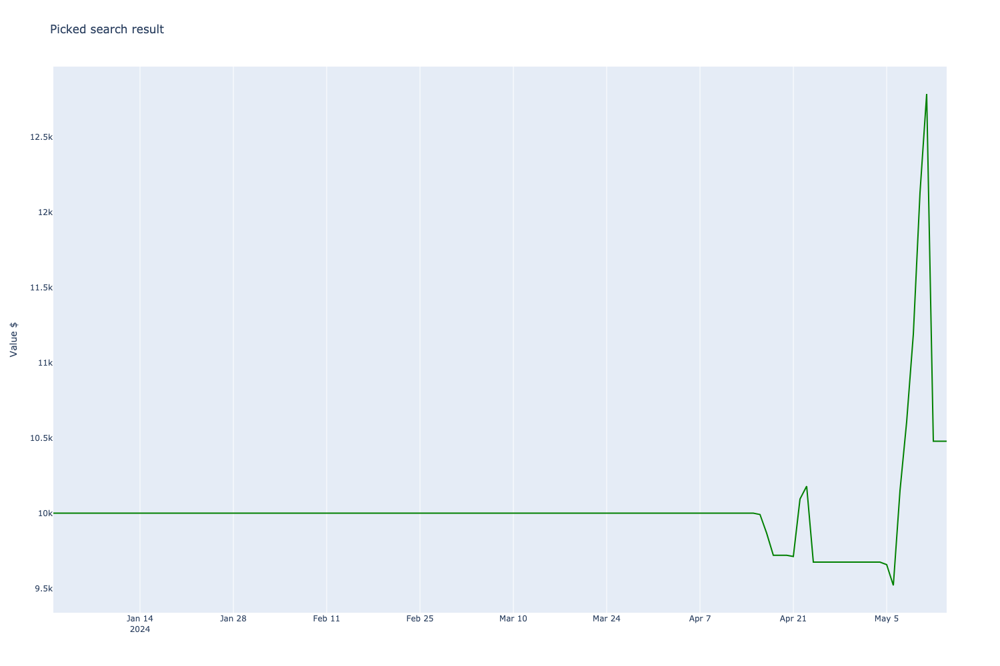

In [22]:
from tradeexecutor.visual.grid_search import visualise_single_grid_search_result_benchmark

# GridSearchResult instance that gave the best performance
best_pick = optimiser_result.results[0].result

print(f"The best result found for {search_func} was {best_pick}")

fig = visualise_single_grid_search_result_benchmark(
    best_pick, 
    strategy_universe, 
    initial_cash=Parameters.initial_cash,
    log_y=False,
)
fig.show()

In [107]:
import pandas as pd
from decimal import Decimal
all_positions = result.state.portfolio.get_all_positions()

def calculate_profits(positions):
    results = []
    
    for pos in positions:
        buy_trade = None
        position_id = pos.position_id
        for trade_id, trade in pos.trades.items():
            if trade.is_buy():
                buy_trade = trade
            elif trade.is_sell():
                if buy_trade is None:
                    continue  # Skip if we haven't found a buy trade yet
                
                buy_price = float(buy_trade.planned_price)
                buy_quantity = float(buy_trade.planned_quantity)
                sell_price = float(trade.planned_price)
                sell_quantity = abs(float(trade.planned_quantity))  # Use abs() as sell quantity is negative
                executed_at = trade.executed_at
                # executed_quantity = trade.executed_quantity
                # executed_reserve = trade.executed_reserve
                unrealized_profit = pos.get_unrealised_and_realised_profit_percent()
                
                profit = (sell_price - buy_price) * sell_quantity
                profit_percentage = (sell_price / buy_price - 1) * 100
                
                # Determine the type of sell
                sell_type = "Unknown"
                if trade.is_partial_take_profit:
                    sell_type = "Partial Take Profit"
                elif trade.is_stoploss():
                    sell_type = "Stop Loss"
                elif trade.planned_price:
                    sell_type = "Take Profit (Planned Price)"

                trade
                
                results.append({
                    'Position ID': position_id,
                    'Trade ID': trade_id,
                    'Buy Price': buy_price,
                    'Sell Price': sell_price,
                    'Sell Quantity': sell_quantity,
                    'Profit': profit,
                    'Profit Percentage': profit_percentage,
                    'Executed At': executed_at,
                    # 'Executed Quantity': float(executed_quantity),
                    # 'Executed Reserve': float(executed_reserve),
                    'Unrealized Profit %': float(unrealized_profit),
                    'Sell Type': sell_type,
                    'Trade Status': trade.get_status(),
                    'Base Token': pos.pair.base.token_symbol
                })
    
    return pd.DataFrame(results)

# Assuming 'all_positions' is your iterable of positions
df_profits = calculate_profits(all_positions)


In [108]:
df_profits

,Position ID,Trade ID,Buy Price,Sell Price,Sell Quantity,Profit,Profit Percentage,Executed At,Unrealized Profit %,Sell Type,Trade Status,Base Token
0,1,2,1.066581e-05,9.567126e-06,1.331357e+08,-146.274308,-10.301008,2024-01-16,-0.103010,Partial Take Profit,TradeStatus.success,MOCHI
1,2,4,1.317441e-05,2.425900e-05,1.062081e+08,1177.273934,84.137328,2024-01-29,0.841373,Partial Take Profit,TradeStatus.success,MOCHI
2,3,6,1.435050e-02,2.978095e-02,1.091531e+05,1684.282203,107.525543,2024-03-13,1.075255,Partial Take Profit,TradeStatus.success,BRETT
3,4,8,3.460398e-02,3.767893e-02,5.217810e+04,160.445034,8.886115,2024-03-17,0.088861,Partial Take Profit,TradeStatus.success,BRETT
4,5,10,2.970613e-02,2.427435e-02,6.154801e+04,-334.315563,-18.285064,2024-03-20,-0.182851,Partial Take Profit,TradeStatus.success,BRETT
5,6,12,3.440925e-02,3.964074e-02,5.175586e+04,270.760313,15.203734,2024-03-27,0.152037,Partial Take Profit,TradeStatus.success,BRETT
6,7,16,6.399030e-02,7.199925e-02,2.843131e+04,227.704910,12.515878,2024-04-11,0.125159,Partial Take Profit,TradeStatus.success,BRETT
7,8,17,6.805980e-03,1.657062e-02,2.293547e+05,2239.566980,143.471512,2024-04-12,1.434715,Partial Take Profit,TradeStatus.success,ANDY
8,9,19,1.707133e-03,1.472827e-03,7.845456e+05,-183.824124,-13.725142,2024-04-13,-0.137251,Partial Take Profit,TradeStatus.success,$poop
9,10,20,5.127117e-09,2.174135e-09,3.860838e+11,-1140.098377,-57.595359,2024-04-14,-0.575954,Partial Take Profit,TradeStatus.success,WOLF


- Visualise some custom indicator data, so we know it looks correct
- We pick one of tokens in the sample data set, and pull outs it custom indicator data generated or loaded during the backtest run

Show raw custom indicator data.

### Technical indicator and trade visualisation
Draw the technical indicators we filled in in decide_trades()
Show the made trades on the price chart for a single trading pair
You need to zoom in to see the bollinger bands, as the default chart width is full multi-year study. However the default notebook chart mode is static images, as interactive images are a bit slow on Github Codespaces.

In [109]:
pairs_dict = {}
sample_pair = None

for pair in strategy_universe.iterate_pairs():
    print(f"Pair : {pair.internal_id} with the following description {pair.get_human_description()} and {pair.get_human_description()}")
    pairs_dict[pair.get_identifier] = pair
    if pair.base.token_symbol == 'BRETT':
        sample_pair = strategy_universe.get_trading_pair(pair.internal_id)

Pair : 3745492 with the following description TYBG-WETH and TYBG-WETH
Pair : 3745445 with the following description AYB-WETH and AYB-WETH
Pair : 3744741 with the following description MOCHI-WETH and MOCHI-WETH
Pair : 3742294 with the following description TOSHI-WETH and TOSHI-WETH
Pair : 3746834 with the following description BRETT-WETH and BRETT-WETH
Pair : 3752364 with the following description toby-WETH and toby-WETH
Pair : 3749856 with the following description Baldo-WETH and Baldo-WETH
Pair : 3751182 with the following description BIRDDOG-WETH and BIRDDOG-WETH
Pair : 3756040 with the following description BUTT-WETH and BUTT-WETH
Pair : 3761502 with the following description ELEPEPE-WETH and ELEPEPE-WETH
Pair : 3761589 with the following description BENJI-WETH and BENJI-WETH
Pair : 3755409 with the following description weirdo-WETH and weirdo-WETH
Pair : 3758967 with the following description MOON-WETH and MOON-WETH
Pair : 3765407 with the following description BOOMER-WETH and BOOM

2024-11-24 17:17:16,758 tradeexecutor.visual.single_pair                   INFO     Visualising <State for base-memecoins>
2024-11-24 17:17:16,906 tradeexecutor.visual.single_pair                   INFO     Visualising single pair for pair (BRETT - WETH) strategy for range 2023-01-01 00:00:00 - 2024-12-01 00:00:00
2024-11-24 17:17:16,909 tradeexecutor.visual.single_pair                   INFO     Candles are 2024-02-24 00:00:00 = 2024-05-15 00:00:00, having 82 candles


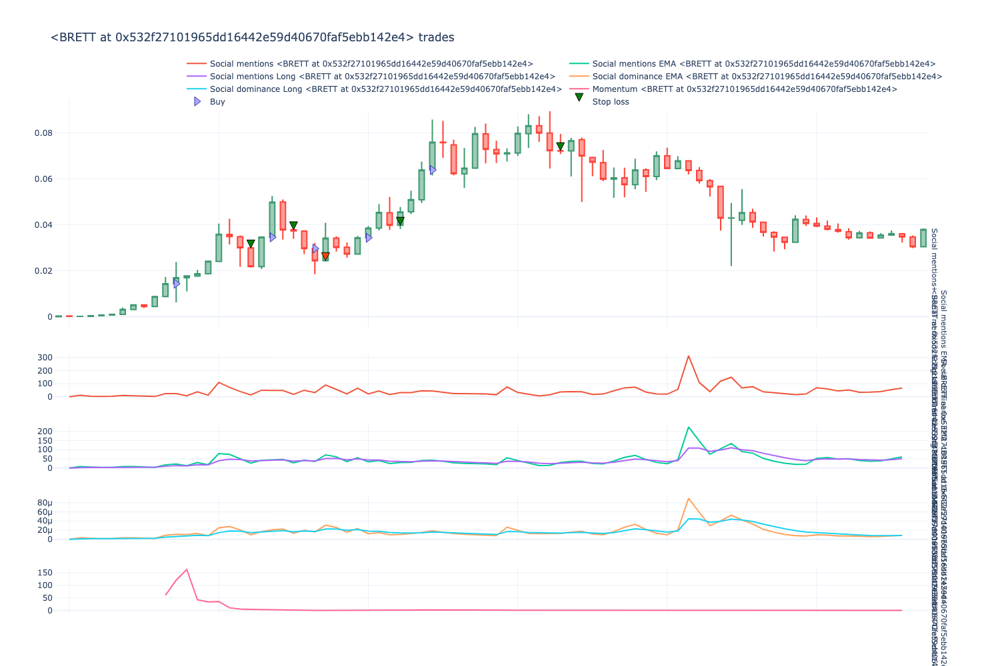

In [110]:

from tradeexecutor.visual.single_pair import visualise_single_pair
# from tradeexecutor.visual.
from tradingstrategy.charting.candle_chart import VolumeBarMode

start_at, end_at = state.get_strategy_start_and_end()   # Limit chart to our backtesting range
# btc_usdt = strategy_universe.get_pair_by_human_description(trading_pairs[0])
# 68900 PEOPLE
# 3228746 PEPE

figure = visualise_single_pair(
    state,
    pair_id=sample_pair.internal_id,
    execution_context=notebook_execution_context,
    candle_universe=strategy_universe.data_universe.candles,
    start_at=pd.Timestamp('2023-01-01'), #start_at,
    end_at=pd.Timestamp('2024-12-01'),#end_at, #pd.Timestamp('2023-10-01'),
    volume_bar_mode=VolumeBarMode.hidden,
    volume_axis_name="Volume (USD)",
    height = 800,
    title=f"{sample_pair.base} trades",
    detached_indicators=True
)

# write_pickle_to_gcs(figure, "test/eth_memecoin_fig_single_pair_latest.pkl")


figure.show()

# Equity curve

- Equity curve shows how your strategy accrues value over time
- A good equity curve has a stable ascending angle
- Benchmark against MATIC buy and hold

/var/folders/vd/s7y9nsh17j58nlkxbx68vhmw0000gn/T/ipykernel_37082/1310356924.py:11: DeprecationWarning:

Pass parameter state instead of portfolio_statistics



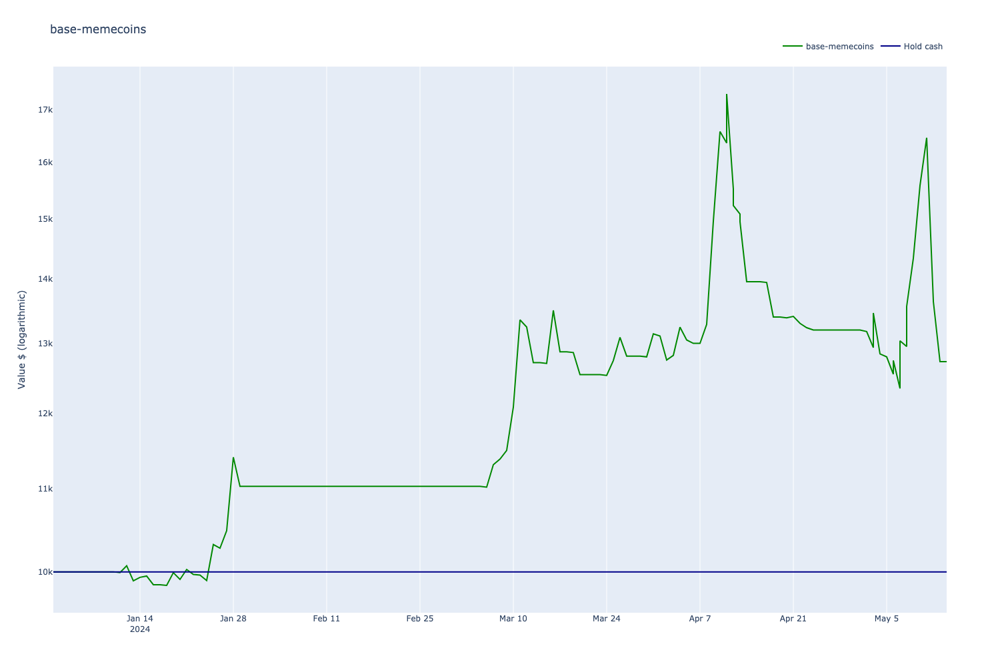

In [111]:
import pandas as pd
from tradeexecutor.analysis.multi_asset_benchmark import get_benchmark_data
from tradeexecutor.visual.benchmark import visualise_equity_curve_benchmark

# Pulls WMATIC/USDC as the benchmark
benchmark_indexes = get_benchmark_data(
    strategy_universe,
    cumulative_with_initial_cash=state.portfolio.get_initial_cash()
)

fig = visualise_equity_curve_benchmark(
    name=state.name,
    portfolio_statistics=state.stats.portfolio,
    all_cash=state.portfolio.get_initial_cash(),
    benchmark_indexes=benchmark_indexes,
    height=800,
    log_y=True,
)

fig.show()

In [20]:
state

NameError: NameError: name 'state' is not defined

In [21]:
import pandas as pd
import plotly.graph_objects as go

# Example to demonstrate using a figure (This should be replaced with your actual fig object)
# fig = go.Figure() # You would actually use your existing 'fig' from your code

# Function to extract data from Plotly figure
def extract_data_from_plotly_fig(fig):
    data = {}
    dates = None

    for trace in fig.data:
        if 'x' in trace and 'y' in trace:
            if dates is None:
                dates = trace.x  # Assuming all traces share the same 'x' dates
            data[trace.name] = trace.y

    # Creating DataFrame
    df = pd.DataFrame(data, index=dates)
    df.index.name = 'Date'
    return df

# Call the function with your figure
df = extract_data_from_plotly_fig(fig)

# Saving the DataFrame to CSV
csv_path = "gs://taraxa-research/test/extracted_trendspotting_backtest_plot_data.csv"
df.to_csv(csv_path)

# Output to check
print(df.head())

NameError: NameError: name 'fig' is not defined

# Performance metrics

- Display portfolio performance metrics
- Compare against buy and hold matic using the same initial capital

In [93]:
from tradeexecutor.analysis.multi_asset_benchmark import compare_strategy_backtest_to_multiple_assets

compare_strategy_backtest_to_multiple_assets(
    state,
    strategy_universe,
    display=True,
)

,Strategy
Start Period,2024-01-01
End Period,2024-05-14
Risk-Free Rate,0.0%
Time in Market,52.0%
Cumulative Return,27.31%
CAGR﹪,93.04%
Sharpe,1.36
Prob. Sharpe Ratio,79.1%
Sortino,2.03
Sortino/√2,1.44


# Trading statistics

- Display summare about made trades

In [94]:
from tradeexecutor.analysis.trade_analyser import build_trade_analysis

analysis = build_trade_analysis(state.portfolio)
summary = analysis.calculate_summary_statistics()
display(summary.to_dataframe())

,0
Trading period length,123 days 0 hours
Trading start,None
Trading end,None
Return %,27.31%
Annualised return %,81.05%
Cash at start,"$10,000.00"
Value at end,"$12,731.12"
Time in market,0.00%
Time in market volatile,0.00%
Trade volume,"$72,612.88"


# Pair breakdown

- Profit for each trading pair

In [94]:
from tradeexecutor.analysis.multipair import analyse_multipair
from tradeexecutor.analysis.multipair import format_multipair_summary

multipair_summary = analyse_multipair(state)
display(format_multipair_summary(multipair_summary))

,Trading pair,Positions,Trades,Total return %,Total PnL USD,Best,Worst,Avg,Median,Volume,Wins,Losses,Take profits,Stop losses,Trailing stop losses,Volatility
9,CAT-WBNB spot,11,22,498.39%,"8,029.02",315.16%,-19.72%,45.31%,-11.84%,"58,935.84",4,7,0,11,4,104.71%
2,BabyDoge-WBNB spot,5,10,193.20%,"3,072.29",188.21%,-17.94%,38.64%,-9.70%,"21,118.88",2,3,0,5,2,78.05%
1,MILO-WBNB spot,3,6,63.65%,-112.01,88.84%,-13.55%,21.22%,-11.64%,"10,708.46",1,2,0,3,1,47.82%
11,PIT-WBNB spot,2,4,59.33%,"1,042.34",69.78%,-10.44%,29.67%,29.67%,"6,102.08",1,1,0,2,1,40.11%
0,FLOKI-WBNB spot,8,16,54.38%,150.22,41.13%,-21.02%,6.80%,-2.14%,"30,279.73",4,4,0,8,4,25.13%
7,KATA-WBNB spot,6,12,25.01%,404.70,39.41%,-15.43%,4.17%,-1.28%,"22,338.30",3,3,0,6,3,19.33%
8,CUMMIES-WBNB spot,4,8,1.38%,-309.43,42.57%,-23.02%,0.34%,-9.09%,"15,219.37",1,3,0,4,2,25.84%
3,DOGE-WBNB spot,2,4,-4.30%,-62.21,10.21%,-14.51%,-2.15%,-2.15%,"4,945.90",1,1,0,2,1,12.36%
16,FEG-WBNB spot,1,2,-10.89%,-307.96,-10.89%,-10.89%,-10.89%,-10.89%,"5,345.72",0,1,0,1,0,0.00%
14,BabyTrump-WBNB spot,1,2,-12.04%,-354.13,-12.04%,-12.04%,-12.04%,-12.04%,"5,527.34",0,1,0,1,0,0.00%


# Sheet 2